## 19.Can KNN be used for the imputation of missing values?

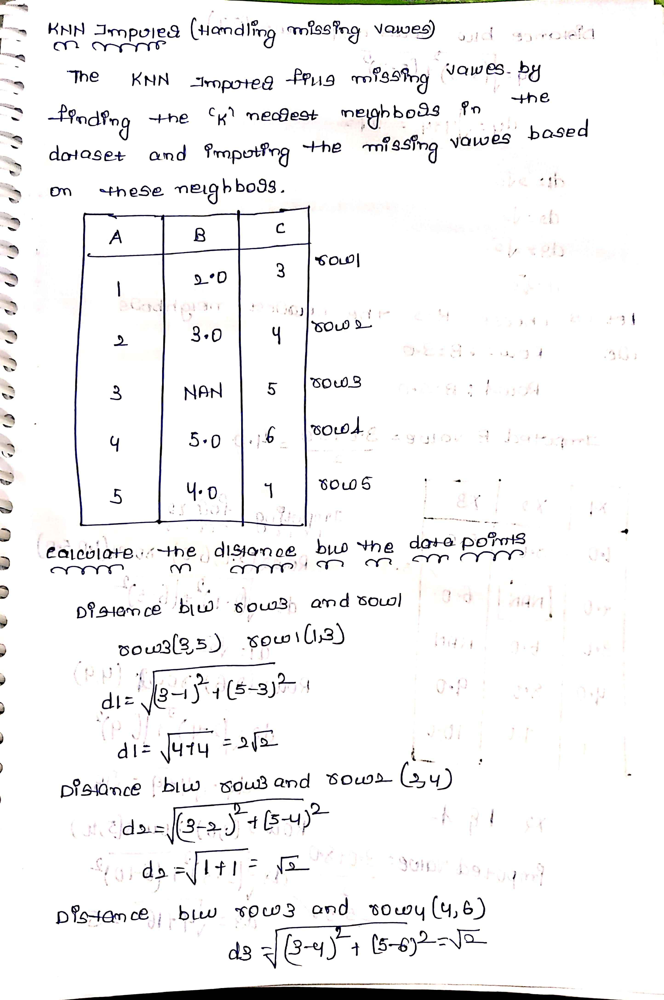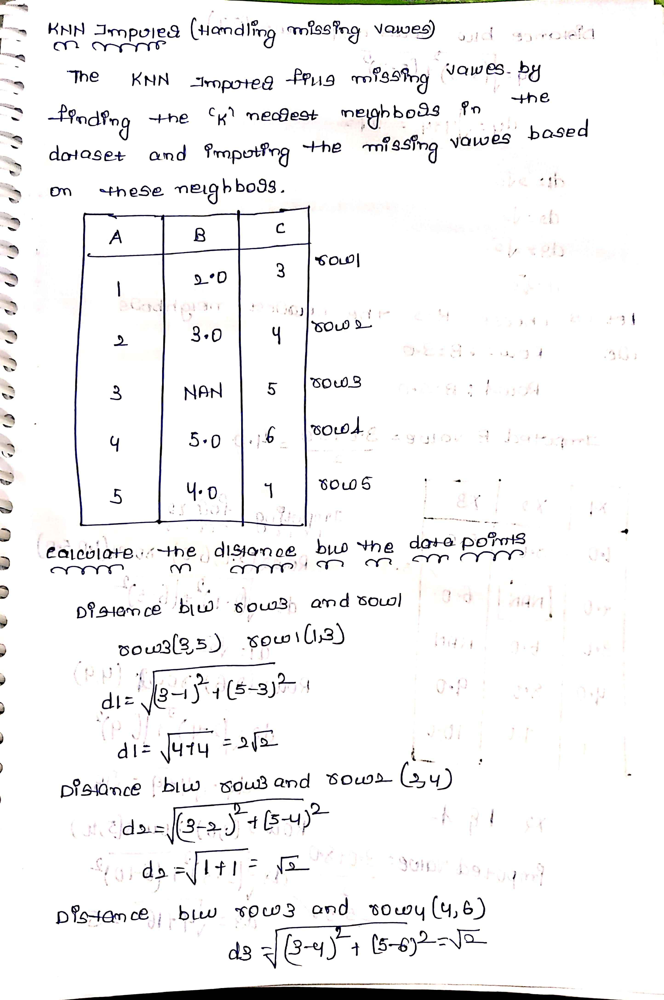




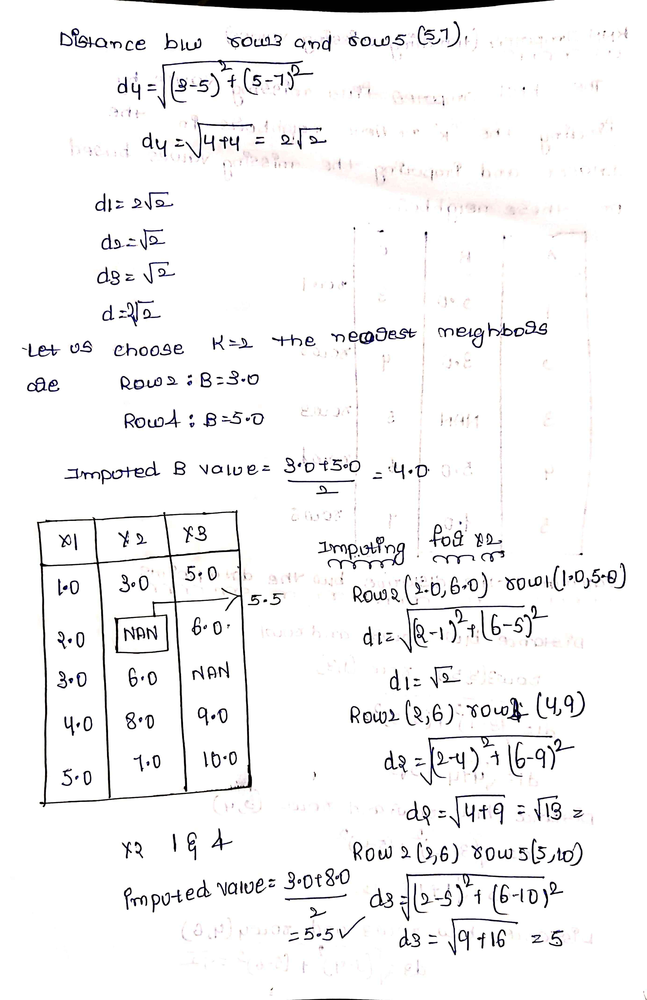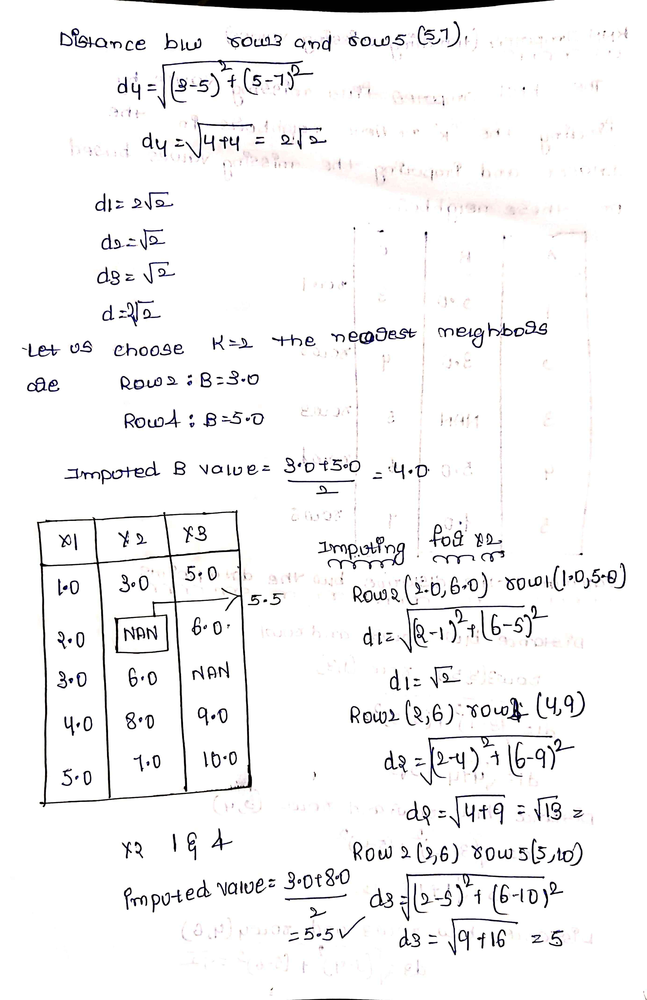

### 20. Example Problem: KNN with Mixed Data (Categorical + Numerical)

#### Dataset

Consider a dataset with both **categorical** and **numerical** features:

| **ID** | **Age** | **Income** | **Color** | **Shape** | **Class** |
|--------|---------|------------|-----------|-----------|-----------|
| 1      | 25      | 50,000     | red       | circle    | A         |
| 2      | 30      | 60,000     | blue      | square    | B         |
| 3      | 22      | 40,000     | green     | circle    | A         |
| 4      | 35      | 55,000     | red       | square    | B         |

#### Test Point

Let the **test point** be `['Age = 28', 'Income = 58,000', 'Color = red', 'Shape = circle']`.

We will calculate the **KNN** distance using both **numerical** and **categorical** features.

---

### Step 1: Separate the Features
- **Numerical features**: Age, Income
- **Categorical features**: Color, Shape

---

### Step 2: Calculate the Distance for Numerical Features (Euclidean)

The **Euclidean distance** formula is:

$$
d_{\text{num}} = \sqrt{(X_1 - X_2)^2 + (Y_1 - Y_2)^2}
$$

Where:
- \( X_1, X_2 \) are the values for **Age**.
- \( Y_1, Y_2 \) are the values for **Income**.

- **Test Point vs Point 1**:
  $$
  d_{\text{num,1}} = \sqrt{(28 - 25)^2 + (58,000 - 50,000)^2} = \sqrt{3^2 + 8,000^2} = \sqrt{9 + 64,000,000} \approx 8,000.001
  $$

- **Test Point vs Point 2**:
  $$
  d_{\text{num,2}} = \sqrt{(28 - 30)^2 + (58,000 - 60,000)^2} = \sqrt{2^2 + 2,000^2} = \sqrt{4 + 4,000,000} \approx 2,000.001
  $$

- **Test Point vs Point 3**:
  $$
  d_{\text{num,3}} = \sqrt{(28 - 22)^2 + (58,000 - 40,000)^2} = \sqrt{6^2 + 18,000^2} = \sqrt{36 + 324,000,000} \approx 18,000.001
  $$

- **Test Point vs Point 4**:
  $$
  d_{\text{num,4}} = \sqrt{(28 - 35)^2 + (58,000 - 55,000)^2} = \sqrt{7^2 + 3,000^2} = \sqrt{49 + 9,000,000} \approx 3,000.001
  $$

---

### Step 3: Calculate the Distance for Categorical Features (Hamming)

The **Hamming distance** for categorical features is calculated as the number of differing values.

- **Test Point vs Point 1** (Color = red, Shape = circle):
  - **Color**: same (red) → 0
  - **Shape**: same (circle) → 0
  - **Hamming Distance**: 0

- **Test Point vs Point 2** (Color = blue, Shape = square):
  - **Color**: different (blue vs red) → 1
  - **Shape**: different (square vs circle) → 1
  - **Hamming Distance**: 2

- **Test Point vs Point 3** (Color = green, Shape = circle):
  - **Color**: different (green vs red) → 1
  - **Shape**: same (circle) → 0
  - **Hamming Distance**: 1

- **Test Point vs Point 4** (Color = red, Shape = square):
  - **Color**: same (red) → 0
  - **Shape**: different (square vs circle) → 1
  - **Hamming Distance**: 1

---

### Step 4: Combine the Distances

We combine the numerical and categorical distances using **equal weights**:

$$
d_{\text{total}} = w_{\text{num}} \cdot d_{\text{num}} + w_{\text{cat}} \cdot d_{\text{cat}}
$$

Assuming \( w_{\text{num}} = 1 \) and \( w_{\text{cat}} = 1 \), the total distances are:

- **Test Point vs Point 1**:
  $$
  d_{\text{total,1}} = 1 \cdot 8,000.001 + 1 \cdot 0 = 8,000.001
  $$

- **Test Point vs Point 2**:
  $$
  d_{\text{total,2}} = 1 \cdot 2,000.001 + 1 \cdot 2 = 2,002.001
  $$

- **Test Point vs Point 3**:
  $$
  d_{\text{total,3}} = 1 \cdot 18,000.001 + 1 \cdot 1 = 18,001.001
  $$

- **Test Point vs Point 4**:
  $$
  d_{\text{total,4}} = 1 \cdot 3,000.001 + 1 \cdot 1 = 3,001.001
  $$

---

### Step 5: Find Nearest Neighbors

We select the **K = 2** nearest neighbors based on the **total distance**:

- The nearest 2 points are:
  - **Point 2** (Distance = 2,002.001, Class = B)
  - **Point 4** (Distance = 3,001.001, Class = B)

---

### Step 6: Majority Voting

Both nearest neighbors belong to **Class B**, so the **predicted class** for the test point is **Class B**.

---

### Final Prediction:

- **Predicted Class**: B


## 22. How Does the Choice of Distance Metric Affect KNN Performance?

```python

The choice of distance metric significantly impacts the performance of KNN because it defines how similarity is measured between data points.

1.Euclidean Distance: Measures the straight-line distance between two points. Works well for continuous numerical data.
Example: In a dataset with height and weight, Euclidean distance can measure how similar two individuals are.
    
2.Manhattan Distance: Sums the absolute differences between the points. It works better when there are many dimensions (features).
Example: In a dataset of location data with large differences between coordinates, Manhattan distance may give a better approximation of similarity.
    
3.Cosine Similarity: Measures the angle between two vectors. It is commonly used in text data and handles sparse data better.
Example: In document classification, cosine similarity measures how similar two documents are based on word frequencies.

Impact: If you use the wrong distance metric, KNN may not capture the correct similarity, leading to poor performance. For example, using Euclidean distance on categorical data might lead to incorrect classifications.

## 23.How would you deal with highly imbalanced dataset using KNN?
Using techniques like
- Oversampling
- Undersampling
- SMOTE

- **Undersampling:** The core idea of undersampling is to decrease the number of instances in the majority class of the target variable. By reducing the size of the majority class, the dataset becomes more balanced, which can help improve model performance on imbalanced datasets. However, this approach might result in the loss of valuable information from the majority class.

******************************************************************************************************************************

- **Oversampling**: The core idea of oversampling is to increase the number of instances in the minority class of the target variable, typically by introducing duplicates of the existing minority class samples. This helps to balance the class distribution but can lead to overfitting, as the model might memorize the repeated instances instead of generalizing well.

*******************************************************************************************************************************

- **SMOTE (Synthetic Minority Over-sampling Technique)**: The core idea of SMOTE is to generate synthetic (artificial) data for the minority class. This is done by creating new examples through a formula where each new instance is derived as:
- **New Instance = Old Instance + Random(0,1) * (Old Instance - Nearest Neighbor)**
- This approach not only balances the classes but also introduces variability in the minority class by creating synthetic instances, thereby reducing the risk of overfitting compared to simple oversampling.

In [6]:
from sklearn.datasets import make_classification
from collections import Counter
import pandas as pd
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler,SMOTE
X,y=make_classification(n_samples=100,weights=[0.05,0.95],random_state=23)
Counter(y)

Counter({1: 95, 0: 5})

In [2]:
# The above dataset is imbalanced i.e, it has majority classes----1(94)
# Minority classes-----0(6)

# Undersampling

In [3]:
rus=RandomUnderSampler()
X_us,y_us=rus.fit_resample(X,y)
Counter(y_us)

Counter({0: 5, 1: 5})

# Oversampling

In [4]:
ros=RandomOverSampler()
X_os,y_os=ros.fit_resample(X,y)
Counter(y_os)

Counter({1: 95, 0: 95})

# SMOTE

In [7]:
smote = SMOTE(k_neighbors=3,random_state=23)
dup = pd.DataFrame(X,y).duplicated().sum()
print("Before Applying SMOTE")
print("*"*30)
print("The Number of Duplicates",dup)
print("The Classes",Counter(y))
X_smote,y_smote = smote.fit_resample(X,y)
print("*"*30)
print("After Applying SMOTE")

dup = pd.DataFrame(X_smote,y_smote).duplicated().sum()
print("The Number of Duplicates",dup)
print("The Classes",Counter(y_smote))

Before Applying SMOTE
******************************
The Number of Duplicates 0
The Classes Counter({1: 95, 0: 5})
******************************
After Applying SMOTE
The Number of Duplicates 0
The Classes Counter({1: 95, 0: 95})
